In [1]:
import os
import random
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
from sklearn.metrics import jaccard_score
from torchvision import transforms
import numpy as np

# Set random seed for reproducibility
def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

seed_everything()

class SegmentationDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        mask_path = self.mask_paths[idx]

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        if self.transform:
            image = self.transform(image)
            mask = transforms.Resize((256, 256))(mask)
            mask = transforms.ToTensor()(mask)

        return image, mask

# Define transformations
train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.RandomAffine(degrees=0, translate=(0.1, 0.1)),
    transforms.RandomPerspective(distortion_scale=0.2, p=0.5),
    transforms.ToTensor(),
])

val_test_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])

# Load dataset paths
image_dir = "/kaggle/input/kvasir-seg/Kvasir-SEG/images"
mask_dir = "/kaggle/input/kvasir-seg/Kvasir-SEG/masks"

images = sorted(os.listdir(image_dir))
masks = sorted(os.listdir(mask_dir))

image_paths = [os.path.join(image_dir, img) for img in images]
mask_paths = [os.path.join(mask_dir, mask) for mask in masks]

# Split into train (85%), validation (10%), and test (5%)
train_imgs, temp_imgs, train_masks, temp_masks = train_test_split(image_paths, mask_paths, test_size=0.15, random_state=42)
val_imgs, test_imgs, val_masks, test_masks = train_test_split(temp_imgs, temp_masks, test_size=0.3333, random_state=42)

# Initialize datasets
train_dataset = SegmentationDataset(train_imgs, train_masks, transform=train_transform)
val_dataset = SegmentationDataset(val_imgs, val_masks, transform=val_test_transform)
test_dataset = SegmentationDataset(test_imgs, test_masks, transform=val_test_transform)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)


In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F


# --- Residual ConvBlock ---
class ResidualConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, dropout=0.0):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Dropout2d(dropout),
            nn.Conv2d(out_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
        )
        self.relu = nn.ReLU(inplace=True)
        self.skip = nn.Conv2d(in_channels, out_channels, 1) if in_channels != out_channels else nn.Identity()

    def forward(self, x):
        residual = self.skip(x)
        out = self.conv(x)
        return self.relu(out + residual)


# --- Attention Block ---
class AttentionBlock(nn.Module):
    def __init__(self, f_g, f_l, f_int):
        super().__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(f_g, f_int, 1, bias=False),
            nn.BatchNorm2d(f_int)
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(f_l, f_int, 1, bias=False),
            nn.BatchNorm2d(f_int)
        )
        self.psi = nn.Sequential(
            nn.Conv2d(f_int, 1, 1, bias=False),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )
        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        return x * self.psi(self.relu(self.W_g(g) + self.W_x(x)))


# --- CBAM ---
class ChannelAttention(nn.Module):
    def __init__(self, in_planes, ratio=8):
        super().__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        self.shared_MLP = nn.Sequential(
            nn.Conv2d(in_planes, in_planes // ratio, 1, bias=False),
            nn.ReLU(),
            nn.Conv2d(in_planes // ratio, in_planes, 1, bias=False)
        )
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        return self.sigmoid(self.shared_MLP(self.avg_pool(x)) + self.shared_MLP(self.max_pool(x)))


class SpatialAttention(nn.Module):
    def __init__(self, kernel_size=7):
        super().__init__()
        padding = kernel_size // 2
        self.conv = nn.Conv2d(2, 1, kernel_size, padding=padding, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out, _ = torch.max(x, dim=1, keepdim=True)
        return self.sigmoid(self.conv(torch.cat([avg_out, max_out], dim=1)))


class CBAM(nn.Module):
    def __init__(self, channels, reduction=8, spatial_kernel=7):
        super().__init__()
        self.ca = ChannelAttention(channels, reduction)
        self.sa = SpatialAttention(spatial_kernel)

    def forward(self, x):
        return x * self.ca(x) * self.sa(x)


# --- Up + Conv ---
class UpConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True),
            nn.Conv2d(in_channels, out_channels, 3, padding=1),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.up(x)


# --- Morphological Gradient Boundary Refinement Module (BRM) ---
class MorphologicalGradientBRM(nn.Module):
    def __init__(self, kernel_size=3):
        super().__init__()
        self.kernel_size = kernel_size
        self.padding = kernel_size // 2
        self.dilate = nn.MaxPool2d(kernel_size, stride=1, padding=self.padding)
        self.erode = nn.MaxPool2d(kernel_size, stride=1, padding=self.padding)

    def forward(self, x):
        dilation = self.dilate(x)
        erosion = -self.erode(-x)
        boundary = dilation - erosion
        return x + boundary  # refine boundaries


# --- Attention UNet++ with BRM ---
class AttentionUNetPlusPlus(nn.Module):
    def __init__(self, in_channels=1, out_channels=1, feature_scale=1, dropout=0.0):
        super().__init__()

        filters = [64, 128, 256, 512, 1024]
        filters = [int(x / feature_scale) for x in filters]

        self.pool = nn.MaxPool2d(2, 2)

        self.encoder1 = ResidualConvBlock(in_channels, filters[0], dropout)
        self.encoder2 = ResidualConvBlock(filters[0], filters[1], dropout)
        self.encoder3 = ResidualConvBlock(filters[1], filters[2], dropout)
        self.encoder4 = ResidualConvBlock(filters[2], filters[3], dropout)
        self.center = ResidualConvBlock(filters[3], filters[4], dropout)

        self.att4 = AttentionBlock(filters[3], filters[3], filters[2])
        self.up4 = UpConv(filters[4], filters[3])
        self.decoder4 = ResidualConvBlock(filters[4], filters[3], dropout)
        self.cbam4 = CBAM(filters[3])

        self.att3 = AttentionBlock(filters[2], filters[2], filters[1])
        self.up3 = UpConv(filters[3], filters[2])
        self.decoder3 = ResidualConvBlock(filters[3], filters[2], dropout)
        self.cbam3 = CBAM(filters[2])

        self.att2 = AttentionBlock(filters[1], filters[1], filters[0])
        self.up2 = UpConv(filters[2], filters[1])
        self.decoder2 = ResidualConvBlock(filters[2], filters[1], dropout)
        self.cbam2 = CBAM(filters[1])

        self.att1 = AttentionBlock(filters[0], filters[0], filters[0] // 2)
        self.up1 = UpConv(filters[1], filters[0])
        self.decoder1 = ResidualConvBlock(filters[1], filters[0], dropout)
        self.cbam1 = CBAM(filters[0])

        # Multi-scale inputs
        self.input_down1 = nn.AvgPool2d(2)
        self.input_down2 = nn.AvgPool2d(4)
        self.input_down3 = nn.AvgPool2d(8)

        # Output layers
        self.out1 = nn.Conv2d(filters[0], out_channels, 1)
        self.out2 = nn.Conv2d(filters[1], out_channels, 1)
        self.out3 = nn.Conv2d(filters[2], out_channels, 1)
        self.out4 = nn.Conv2d(filters[3], out_channels, 1)

        # BRM
        self.brm = MorphologicalGradientBRM(kernel_size=3)

    def forward(self, x):
        # Multi-scale input fusion
        x1 = x
        x2 = F.interpolate(self.input_down1(x), scale_factor=2, mode='bilinear', align_corners=True)
        x3 = F.interpolate(self.input_down2(x), scale_factor=4, mode='bilinear', align_corners=True)
        x4 = F.interpolate(self.input_down3(x), scale_factor=8, mode='bilinear', align_corners=True)
        x = (x1 + x2 + x3 + x4) / 4

        e1 = self.encoder1(x)
        e2 = self.encoder2(self.pool(e1))
        e3 = self.encoder3(self.pool(e2))
        e4 = self.encoder4(self.pool(e3))
        center = self.center(self.pool(e4))

        d4 = self.up4(center)
        e4 = self.att4(d4, e4)
        d4 = self.decoder4(torch.cat([d4, e4], dim=1))
        d4 = self.cbam4(d4)

        d3 = self.up3(d4)
        e3 = self.att3(d3, e3)
        d3 = self.decoder3(torch.cat([d3, e3], dim=1))
        d3 = self.cbam3(d3)

        d2 = self.up2(d3)
        e2 = self.att2(d2, e2)
        d2 = self.decoder2(torch.cat([d2, e2], dim=1))
        d2 = self.cbam2(d2)

        d1 = self.up1(d2)
        e1 = self.att1(d1, e1)
        d1 = self.decoder1(torch.cat([d1, e1], dim=1))
        d1 = self.cbam1(d1)

        out_main = self.out1(d1)
        out_main_refined = self.brm(out_main)  # Apply BRM

        # Deep supervision
        out_aux1 = F.interpolate(self.out2(d2), size=out_main.shape[2:], mode='bilinear', align_corners=True)
        out_aux2 = F.interpolate(self.out3(d3), size=out_main.shape[2:], mode='bilinear', align_corners=True)
        out_aux3 = F.interpolate(self.out4(d4), size=out_main.shape[2:], mode='bilinear', align_corners=True)

        return out_main_refined, out_aux1, out_aux2, out_aux3


# --- Test the model ---
if __name__ == "__main__":
    model = AttentionUNetPlusPlus(in_channels=1, out_channels=1, dropout=0.1)
    x = torch.randn(1, 1, 256, 256)
    outputs = model(x)
    for i, out in enumerate(outputs):
        print(f"Output {i+1} shape: {out.shape}")


Output 1 shape: torch.Size([1, 1, 256, 256])
Output 2 shape: torch.Size([1, 1, 256, 256])
Output 3 shape: torch.Size([1, 1, 256, 256])
Output 4 shape: torch.Size([1, 1, 256, 256])


In [3]:

epochs = 100
lr = 1e-4

In [4]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms
import matplotlib.pyplot as plt
from tqdm import tqdm

def visualize_predictions(loader, title, save_path=None):
    model.eval()
    with torch.no_grad():
        inputs, targets = next(iter(loader))
        inputs, targets = inputs.to(device), targets.to(device)

        raw_outputs = model(inputs)
        if isinstance(raw_outputs, tuple):
            main_output = raw_outputs[0]
        else:
            main_output = raw_outputs

        outputs = (torch.sigmoid(main_output) > 0.5).float()

        fig, axes = plt.subplots(3, 5, figsize=(15, 9))
        for i in range(5):
            img = inputs[i].cpu().permute(1, 2, 0) if inputs.shape[1] == 3 else inputs[i, 0].cpu()
            axes[0, i].imshow(img, cmap='gray' if inputs.shape[1] == 1 else None)
            axes[1, i].imshow(targets[i].cpu().squeeze(), cmap='gray')
            axes[2, i].imshow(outputs[i].cpu().squeeze(), cmap='gray')
            for ax in axes[:, i]:
                ax.axis("off")

        plt.suptitle(title)
        plt.tight_layout()
        if save_path:
            plt.savefig(save_path)
        plt.show()


# --- Hyperparameters ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



# --- Model, Optimizer ---
model = AttentionUNetPlusPlus(in_channels=3, out_channels=1).to(device)
optimizer = optim.Adam(model.parameters(), lr=lr)


Epoch 1/100: 100%|██████████| 107/107 [01:14<00:00,  1.43it/s, loss=1.05]



Epoch 1: Train Loss=1.2469 | Val Loss=1.0206 | Dice=0.4365 | IoU=0.3076

✅ Best model saved: checkpoints/best_model_epoch1_dice0.4365.pth


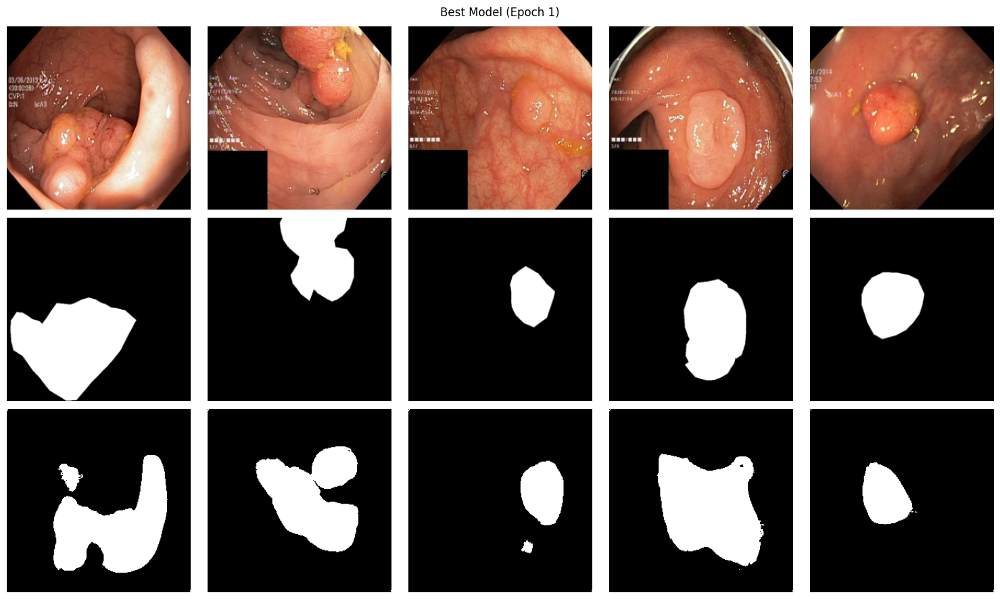

Epoch 2/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.977]



Epoch 2: Train Loss=1.0921 | Val Loss=0.9918 | Dice=0.4604 | IoU=0.3288

✅ Best model saved: checkpoints/best_model_epoch2_dice0.4604.pth


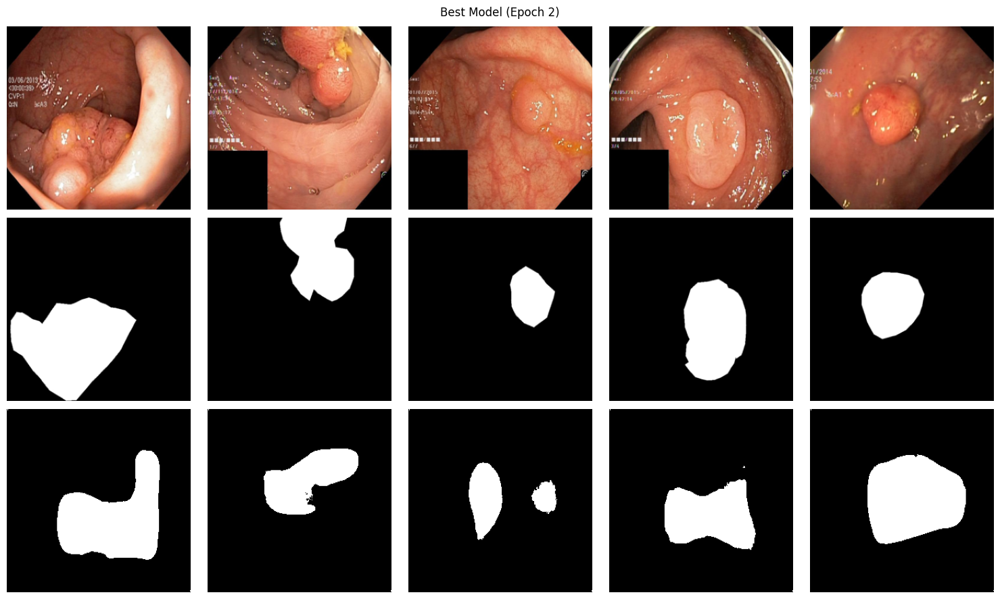

Epoch 3/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.693]



Epoch 3: Train Loss=1.0705 | Val Loss=0.9651 | Dice=0.4786 | IoU=0.3495

✅ Best model saved: checkpoints/best_model_epoch3_dice0.4786.pth


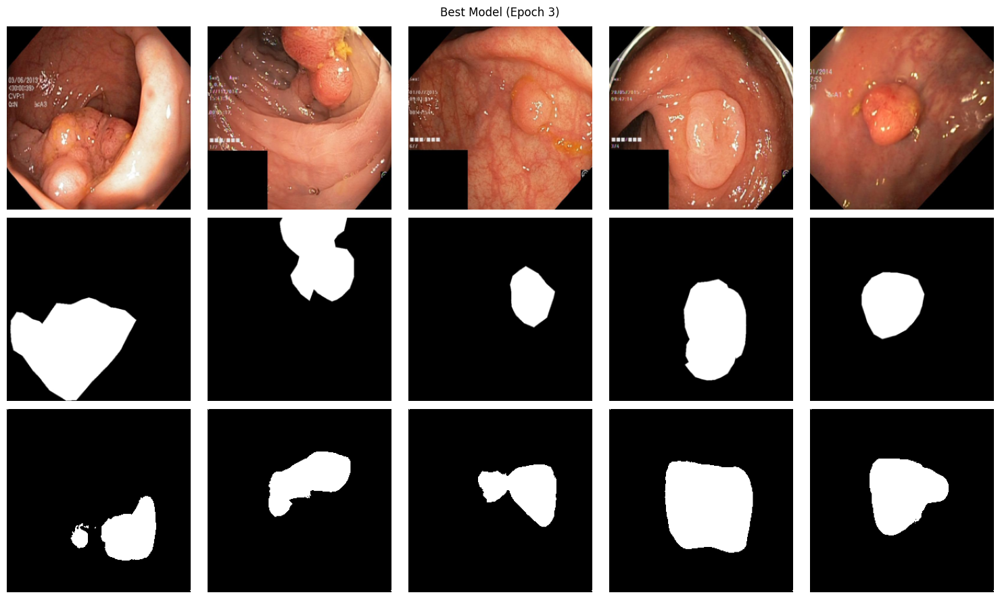

Epoch 4/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.23]



Epoch 4: Train Loss=1.0543 | Val Loss=0.9957 | Dice=0.4313 | IoU=0.3067



Epoch 5/100: 100%|██████████| 107/107 [01:01<00:00,  1.75it/s, loss=1.03]



Epoch 5: Train Loss=1.0414 | Val Loss=0.9414 | Dice=0.4863 | IoU=0.3583

✅ Best model saved: checkpoints/best_model_epoch5_dice0.4863.pth


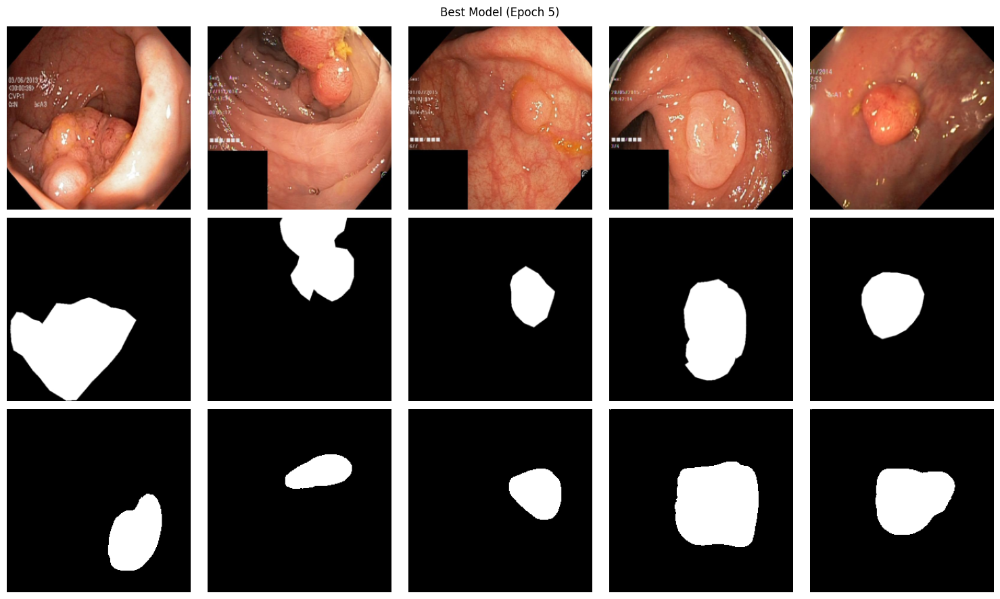

Epoch 6/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.13]



Epoch 6: Train Loss=1.0488 | Val Loss=0.9894 | Dice=0.4312 | IoU=0.3107



Epoch 7/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.04]



Epoch 7: Train Loss=1.0423 | Val Loss=0.9191 | Dice=0.5067 | IoU=0.3769

✅ Best model saved: checkpoints/best_model_epoch7_dice0.5067.pth


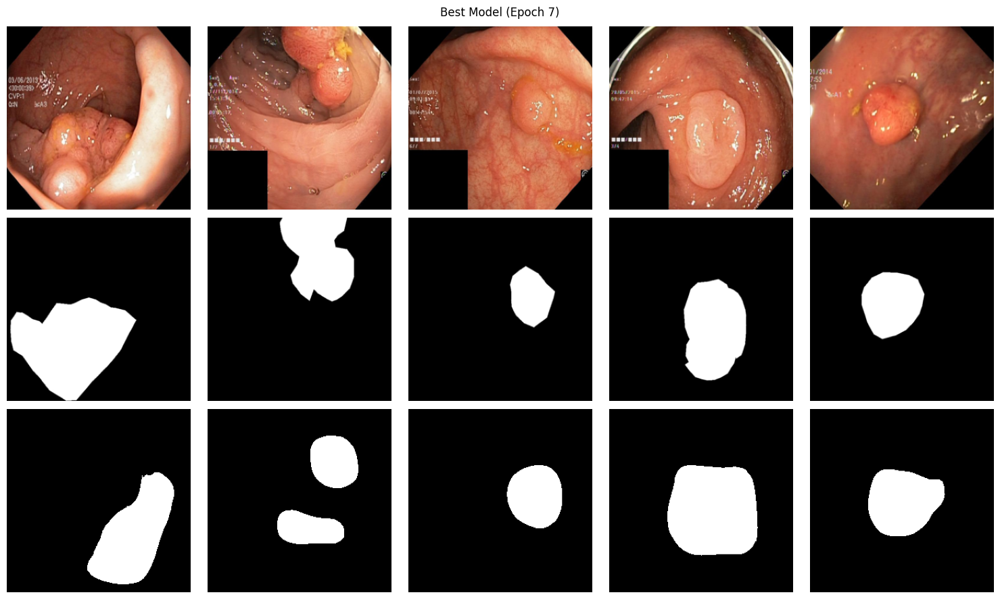

Epoch 8/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.07]



Epoch 8: Train Loss=1.0291 | Val Loss=0.9514 | Dice=0.4626 | IoU=0.3322



Epoch 9/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=0.76]



Epoch 9: Train Loss=1.0271 | Val Loss=0.9161 | Dice=0.5025 | IoU=0.3724



Epoch 10/100: 100%|██████████| 107/107 [01:00<00:00,  1.78it/s, loss=1.29]



Epoch 10: Train Loss=1.0289 | Val Loss=0.9081 | Dice=0.5243 | IoU=0.3916

✅ Best model saved: checkpoints/best_model_epoch10_dice0.5243.pth


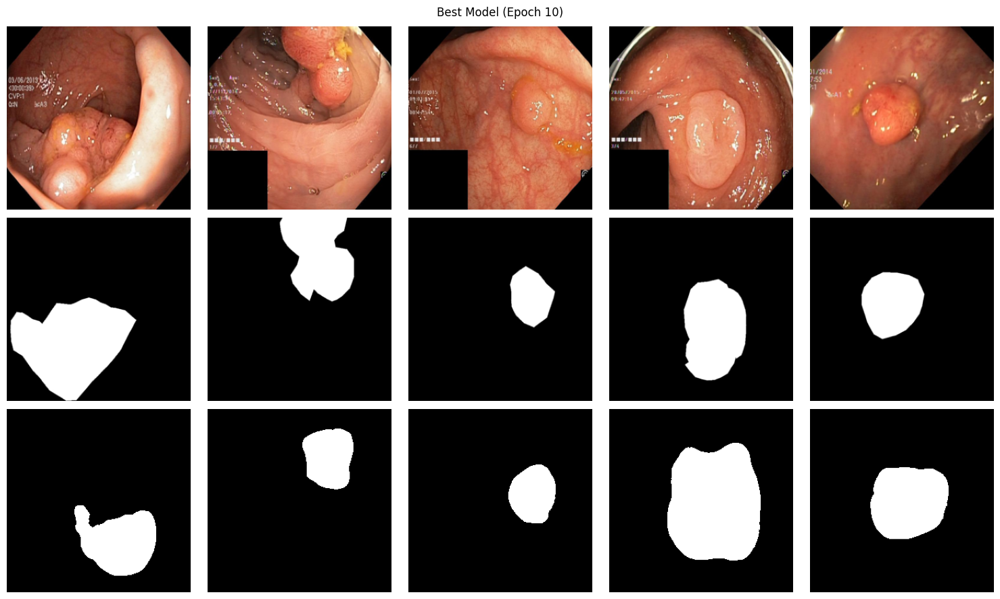

Epoch 11/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.12]



Epoch 11: Train Loss=1.0178 | Val Loss=0.8822 | Dice=0.5427 | IoU=0.4050

✅ Best model saved: checkpoints/best_model_epoch11_dice0.5427.pth


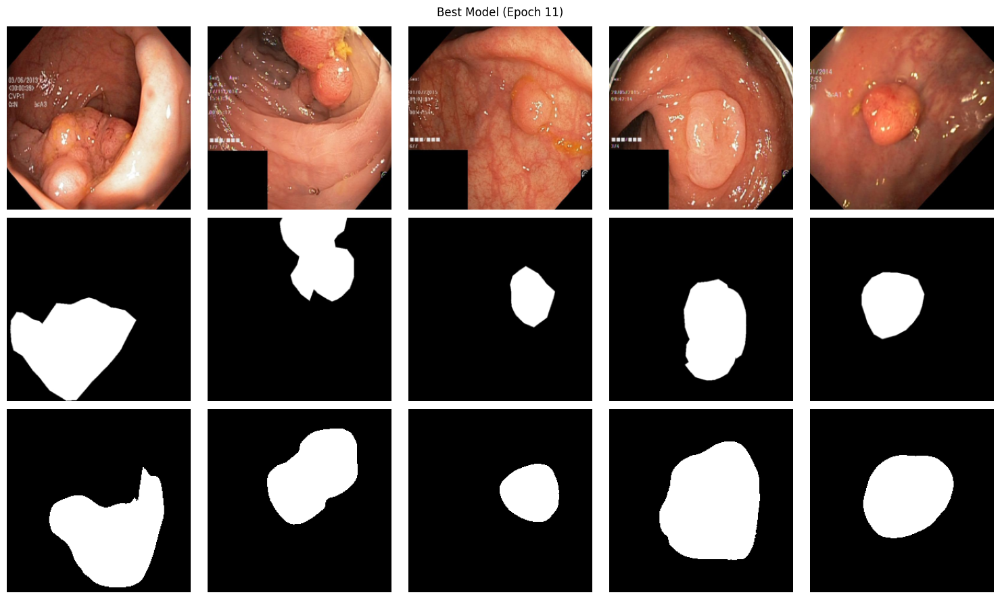

Epoch 12/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.32]



Epoch 12: Train Loss=1.0125 | Val Loss=0.8978 | Dice=0.5255 | IoU=0.3904



Epoch 13/100: 100%|██████████| 107/107 [01:00<00:00,  1.78it/s, loss=1.28]



Epoch 13: Train Loss=1.0129 | Val Loss=0.8982 | Dice=0.5165 | IoU=0.3823



Epoch 14/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.47]



Epoch 14: Train Loss=1.0052 | Val Loss=0.9571 | Dice=0.4494 | IoU=0.3266



Epoch 15/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.03]



Epoch 15: Train Loss=0.9972 | Val Loss=0.8519 | Dice=0.5485 | IoU=0.4140

✅ Best model saved: checkpoints/best_model_epoch15_dice0.5485.pth


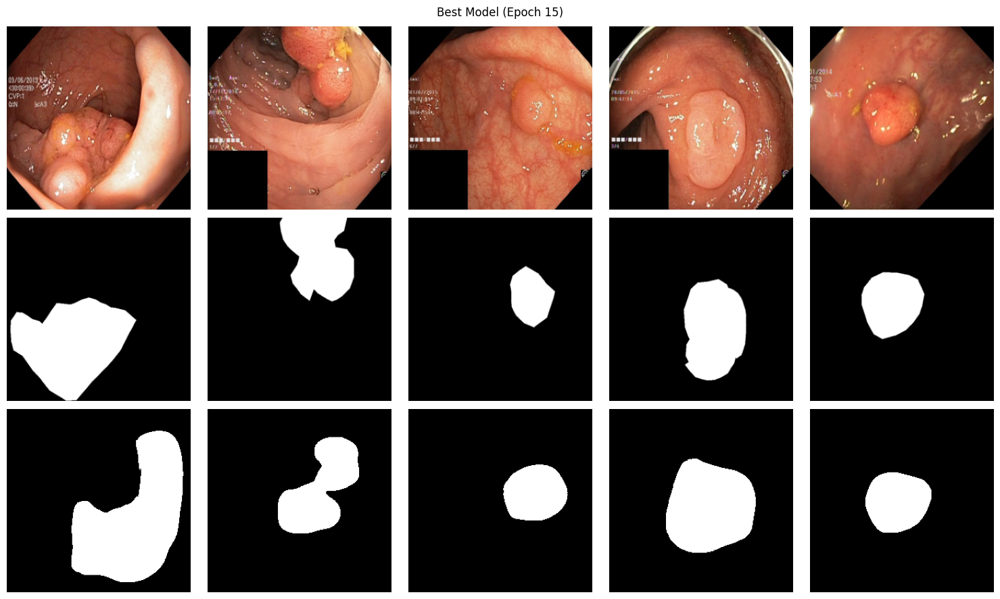

Epoch 16/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.25]



Epoch 16: Train Loss=0.9951 | Val Loss=0.9133 | Dice=0.4900 | IoU=0.3652



Epoch 17/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.29]



Epoch 17: Train Loss=0.9921 | Val Loss=0.8289 | Dice=0.5637 | IoU=0.4313

✅ Best model saved: checkpoints/best_model_epoch17_dice0.5637.pth


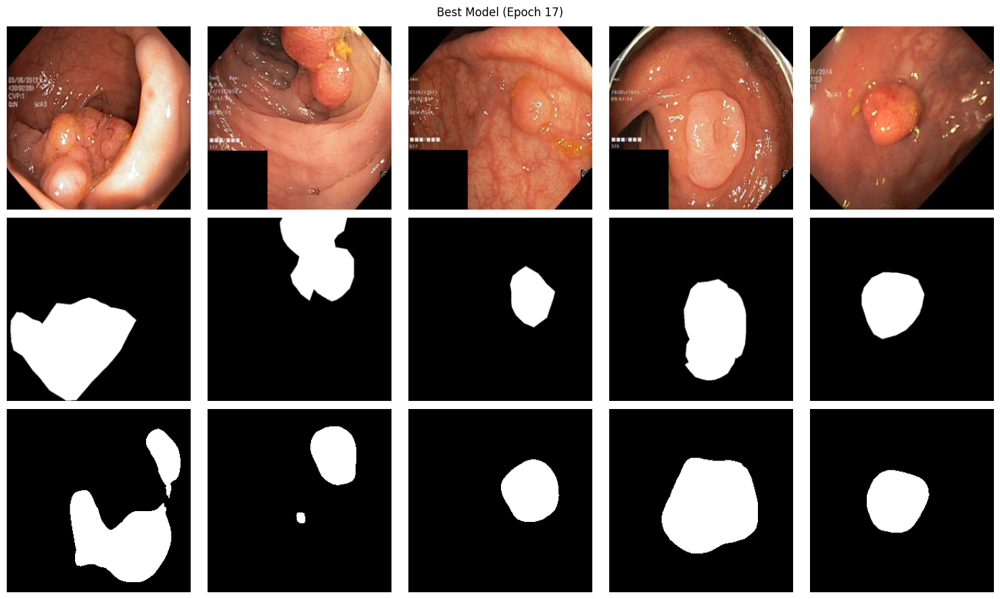

Epoch 18/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.06]



Epoch 18: Train Loss=0.9800 | Val Loss=0.8457 | Dice=0.5642 | IoU=0.4218

✅ Best model saved: checkpoints/best_model_epoch18_dice0.5642.pth


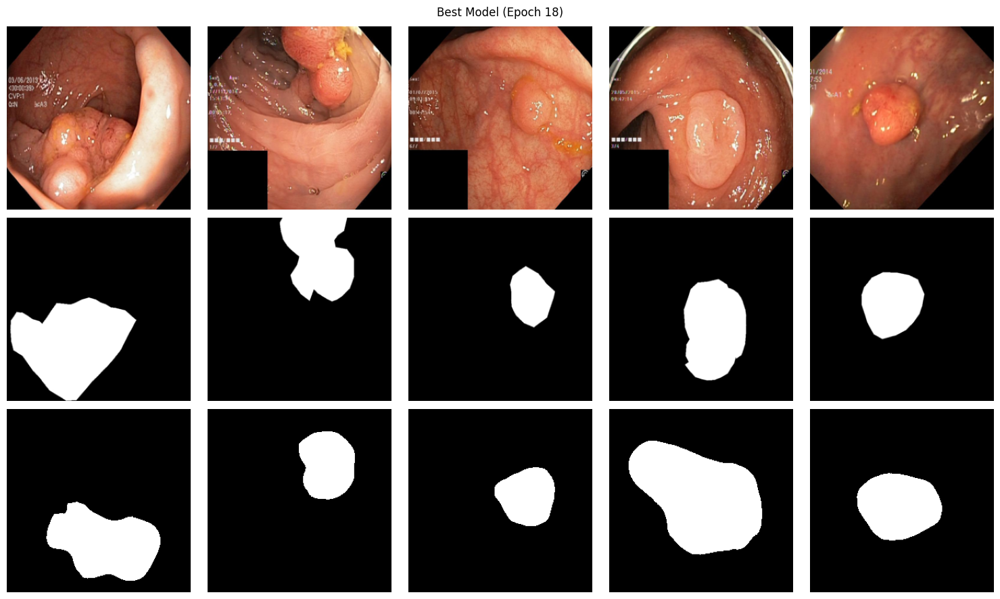

Epoch 19/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.15]



Epoch 19: Train Loss=0.9702 | Val Loss=0.8214 | Dice=0.5838 | IoU=0.4467

✅ Best model saved: checkpoints/best_model_epoch19_dice0.5838.pth


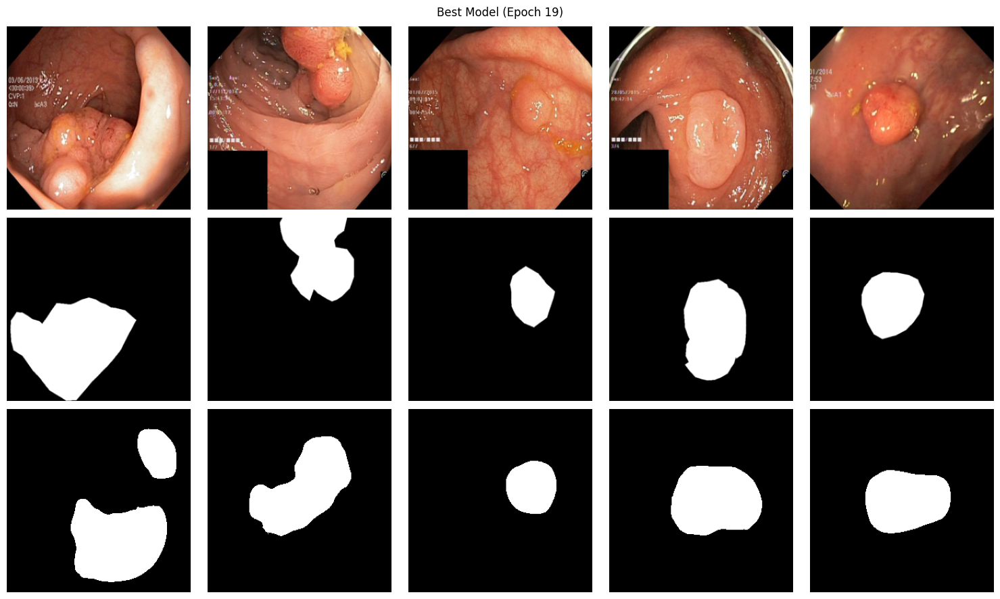

Epoch 20/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.74]



Epoch 20: Train Loss=0.9687 | Val Loss=0.7993 | Dice=0.5948 | IoU=0.4576

✅ Best model saved: checkpoints/best_model_epoch20_dice0.5948.pth


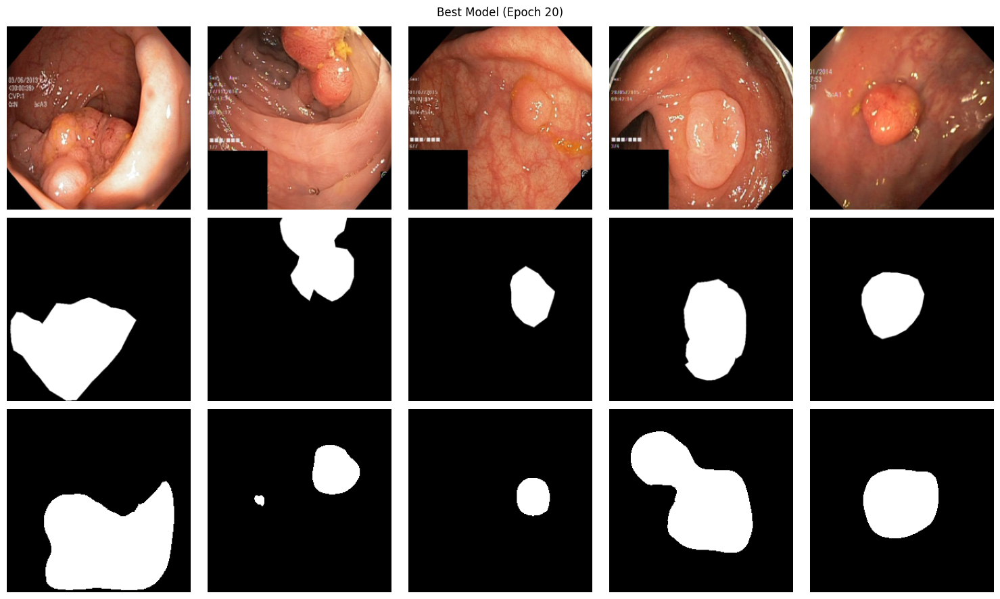

Epoch 21/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=0.973]



Epoch 21: Train Loss=0.9526 | Val Loss=0.7945 | Dice=0.5677 | IoU=0.4373



Epoch 22/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.4]



Epoch 22: Train Loss=0.9604 | Val Loss=0.8046 | Dice=0.5764 | IoU=0.4347



Epoch 23/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=0.688]



Epoch 23: Train Loss=0.9468 | Val Loss=0.7369 | Dice=0.6301 | IoU=0.4917

✅ Best model saved: checkpoints/best_model_epoch23_dice0.6301.pth


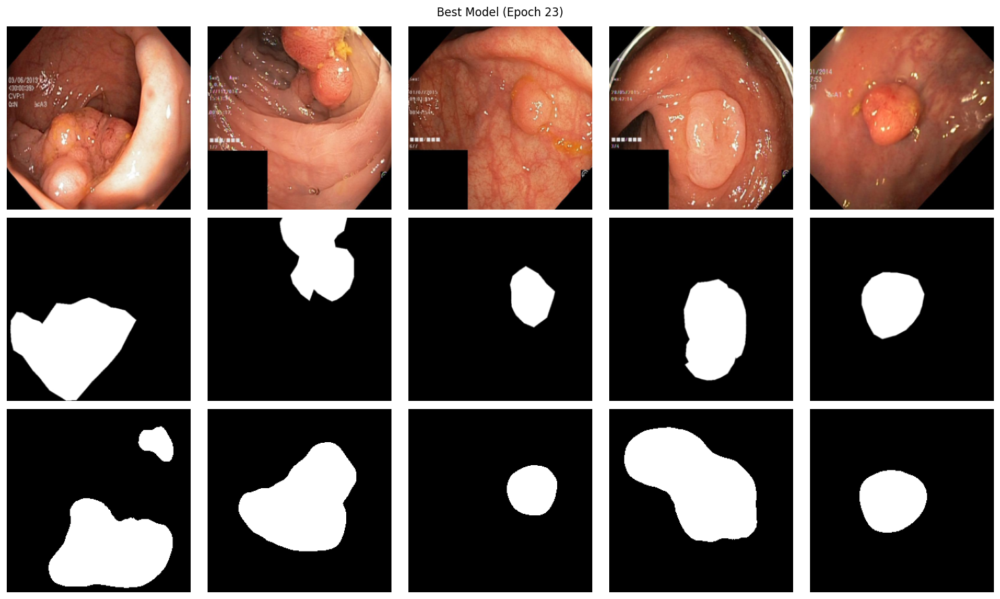

Epoch 24/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.721]



Epoch 24: Train Loss=0.9403 | Val Loss=0.7939 | Dice=0.5752 | IoU=0.4375



Epoch 25/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=0.7]



Epoch 25: Train Loss=0.9201 | Val Loss=0.7636 | Dice=0.6159 | IoU=0.4783



Epoch 26/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.832]



Epoch 26: Train Loss=0.9290 | Val Loss=0.7635 | Dice=0.6194 | IoU=0.4832



Epoch 27/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.97]



Epoch 27: Train Loss=0.9066 | Val Loss=0.8740 | Dice=0.5790 | IoU=0.4412



Epoch 28/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.699]



Epoch 28: Train Loss=0.8989 | Val Loss=0.6969 | Dice=0.6337 | IoU=0.5011

✅ Best model saved: checkpoints/best_model_epoch28_dice0.6337.pth


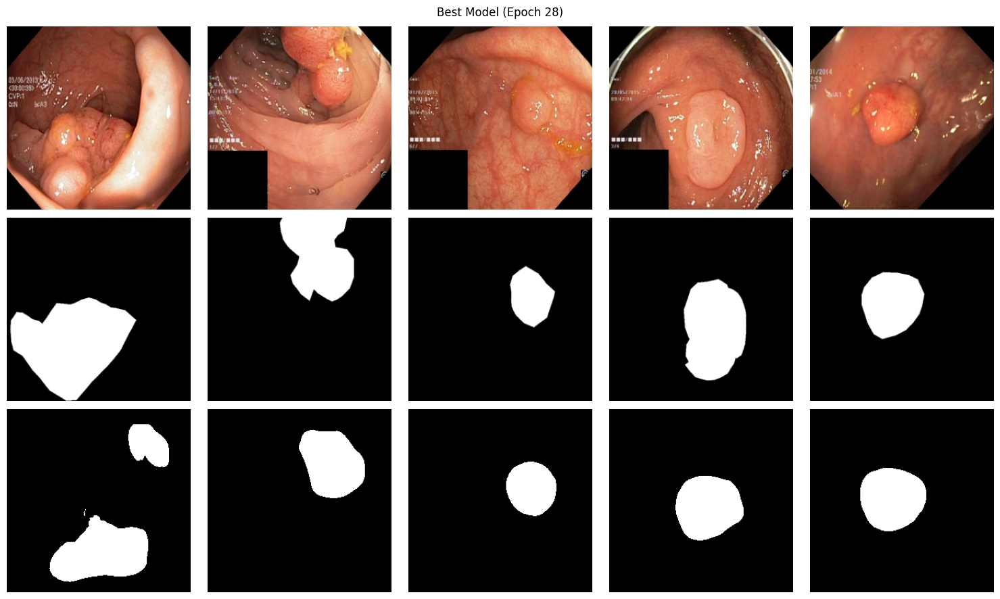

Epoch 29/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.873]



Epoch 29: Train Loss=0.8847 | Val Loss=0.7164 | Dice=0.6449 | IoU=0.5128

✅ Best model saved: checkpoints/best_model_epoch29_dice0.6449.pth


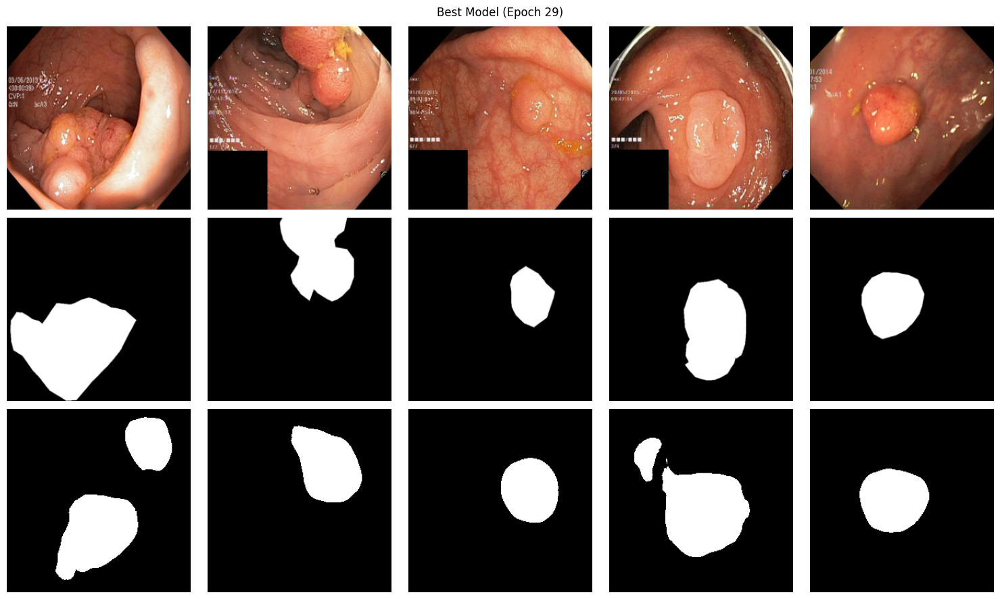

Epoch 30/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.13]



Epoch 30: Train Loss=0.8649 | Val Loss=0.6891 | Dice=0.6781 | IoU=0.5473

✅ Best model saved: checkpoints/best_model_epoch30_dice0.6781.pth


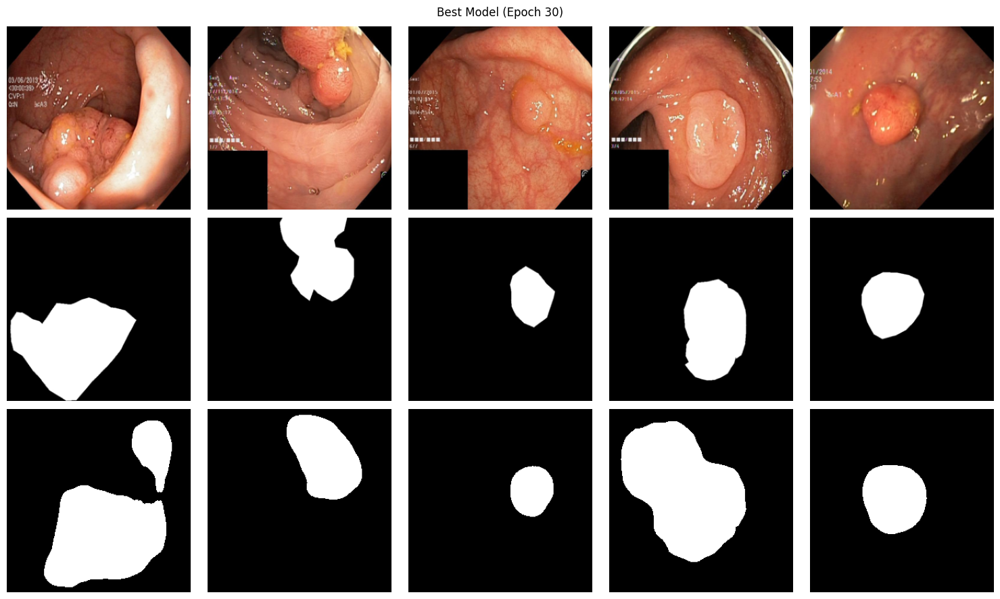

Epoch 31/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=0.74]



Epoch 31: Train Loss=0.8561 | Val Loss=0.6533 | Dice=0.6726 | IoU=0.5384



Epoch 32/100: 100%|██████████| 107/107 [01:00<00:00,  1.78it/s, loss=0.867]



Epoch 32: Train Loss=0.8394 | Val Loss=0.6359 | Dice=0.6841 | IoU=0.5544

✅ Best model saved: checkpoints/best_model_epoch32_dice0.6841.pth


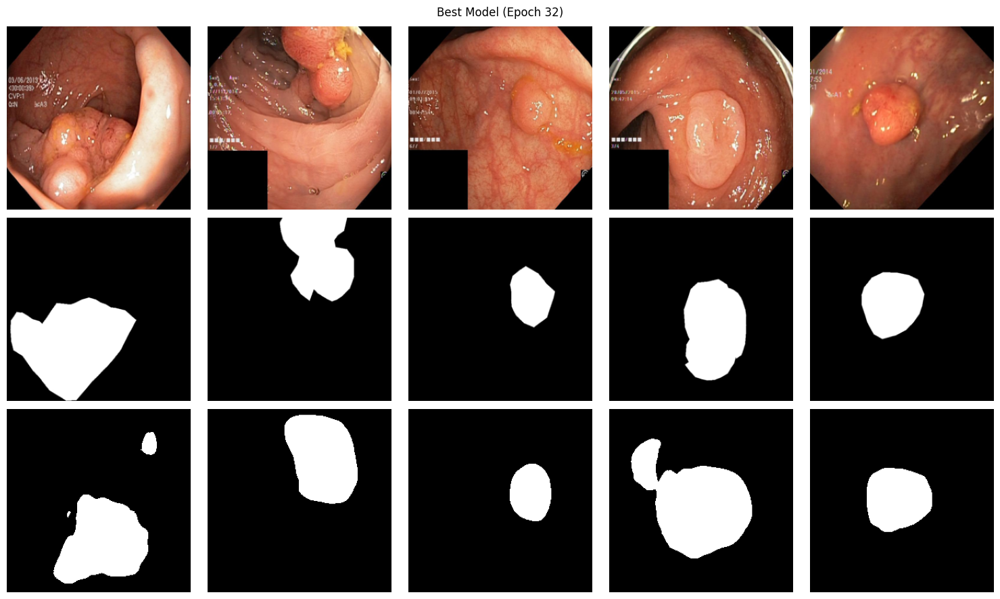

Epoch 33/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=1.63]



Epoch 33: Train Loss=0.8218 | Val Loss=0.6129 | Dice=0.7048 | IoU=0.5768

✅ Best model saved: checkpoints/best_model_epoch33_dice0.7048.pth


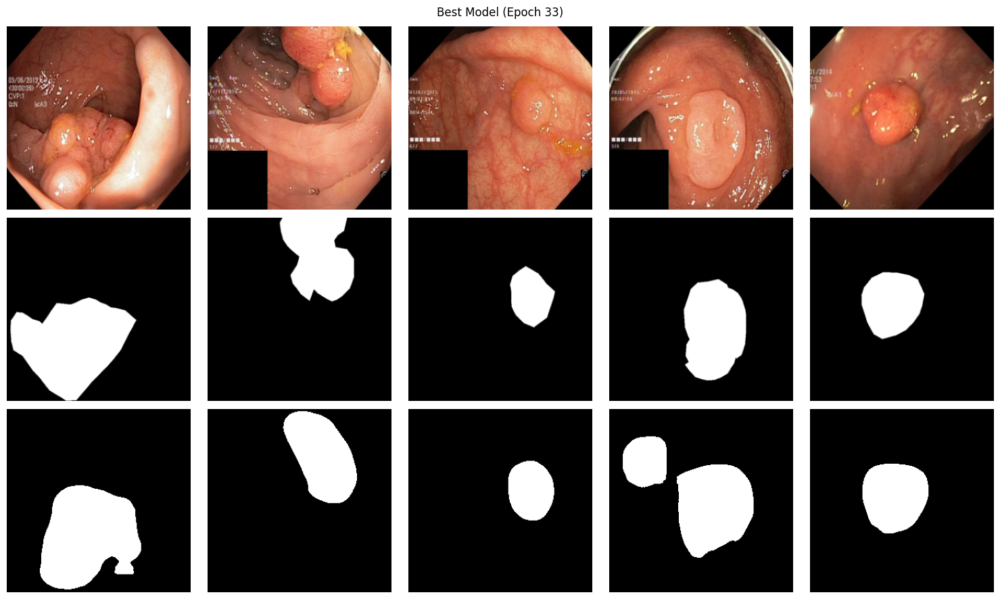

Epoch 34/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.746]



Epoch 34: Train Loss=0.8210 | Val Loss=0.6946 | Dice=0.6438 | IoU=0.5168



Epoch 35/100: 100%|██████████| 107/107 [01:00<00:00,  1.77it/s, loss=0.551]



Epoch 35: Train Loss=0.8124 | Val Loss=0.6668 | Dice=0.6641 | IoU=0.5301



Epoch 36/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.511]



Epoch 36: Train Loss=0.7881 | Val Loss=0.6546 | Dice=0.6578 | IoU=0.5212



Epoch 37/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.471]



Epoch 37: Train Loss=0.7694 | Val Loss=0.6055 | Dice=0.6797 | IoU=0.5476



Epoch 38/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.538]



Epoch 38: Train Loss=0.7554 | Val Loss=0.6256 | Dice=0.6857 | IoU=0.5605



Epoch 39/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.38]



Epoch 39: Train Loss=0.7497 | Val Loss=0.6145 | Dice=0.6552 | IoU=0.5164



Epoch 40/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.953]



Epoch 40: Train Loss=0.7245 | Val Loss=0.5828 | Dice=0.7023 | IoU=0.5722



Epoch 41/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.545]



Epoch 41: Train Loss=0.7145 | Val Loss=0.5858 | Dice=0.6894 | IoU=0.5571



Epoch 42/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.04]



Epoch 42: Train Loss=0.7069 | Val Loss=0.6007 | Dice=0.6913 | IoU=0.5630



Epoch 43/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.09]



Epoch 43: Train Loss=0.6979 | Val Loss=0.5431 | Dice=0.7282 | IoU=0.5987

✅ Best model saved: checkpoints/best_model_epoch43_dice0.7282.pth


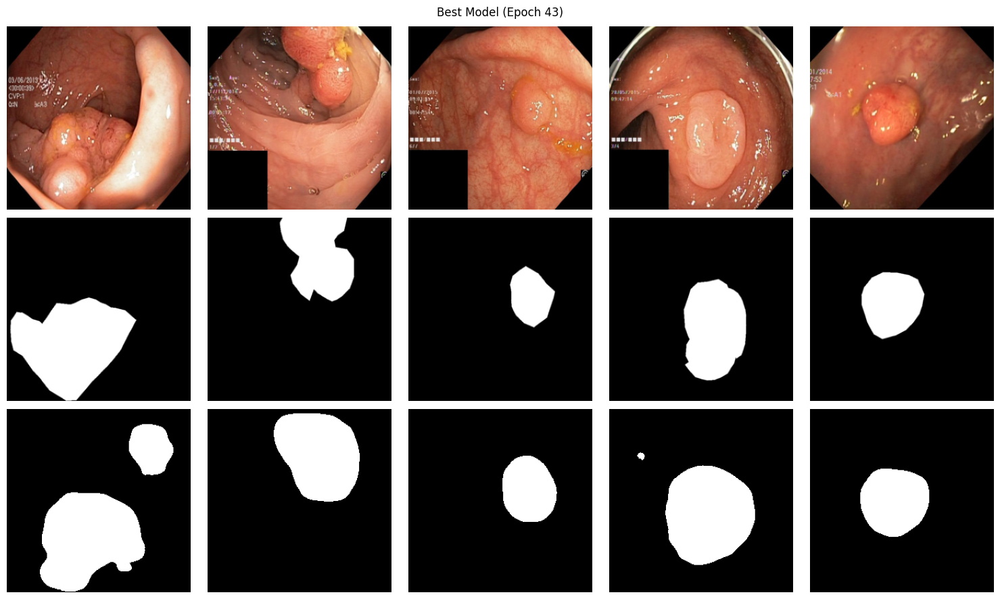

Epoch 44/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.404]



Epoch 44: Train Loss=0.6691 | Val Loss=0.5671 | Dice=0.6916 | IoU=0.5649



Epoch 45/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.506]



Epoch 45: Train Loss=0.6523 | Val Loss=0.6340 | Dice=0.6404 | IoU=0.5008



Epoch 46/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.455]



Epoch 46: Train Loss=0.6427 | Val Loss=0.5536 | Dice=0.6979 | IoU=0.5682



Epoch 47/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.06]



Epoch 47: Train Loss=0.6326 | Val Loss=0.5795 | Dice=0.6830 | IoU=0.5555



Epoch 48/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.713]



Epoch 48: Train Loss=0.6318 | Val Loss=0.5103 | Dice=0.7335 | IoU=0.6090

✅ Best model saved: checkpoints/best_model_epoch48_dice0.7335.pth


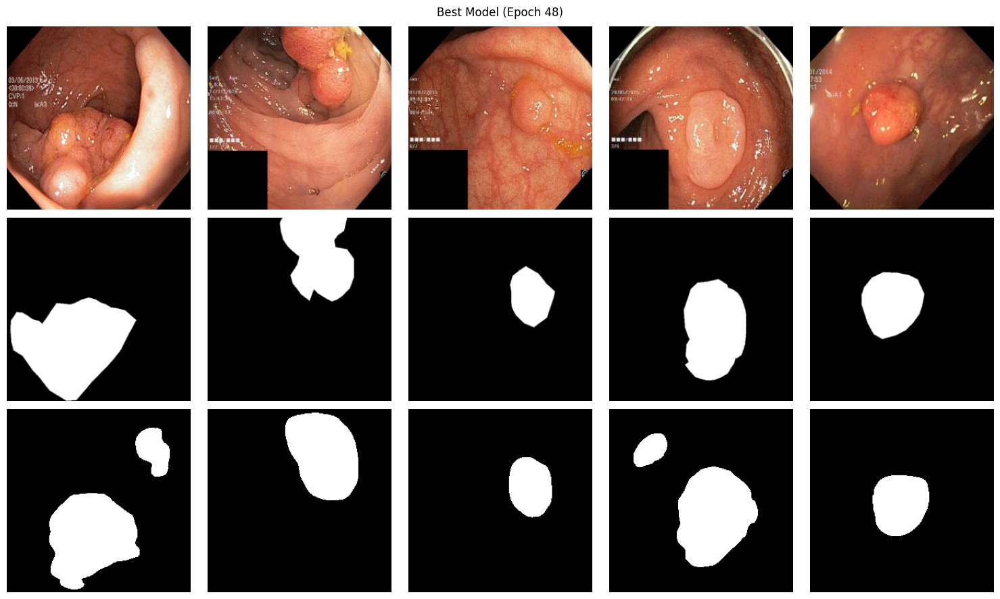

Epoch 49/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.818]



Epoch 49: Train Loss=0.6307 | Val Loss=0.5507 | Dice=0.7145 | IoU=0.5889



Epoch 50/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.514]



Epoch 50: Train Loss=0.6083 | Val Loss=0.5381 | Dice=0.7253 | IoU=0.5990



Epoch 51/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.8]



Epoch 51: Train Loss=0.5905 | Val Loss=0.5238 | Dice=0.7085 | IoU=0.5756



Epoch 52/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.399]



Epoch 52: Train Loss=0.5955 | Val Loss=0.5743 | Dice=0.6970 | IoU=0.5657



Epoch 53/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.417]



Epoch 53: Train Loss=0.5848 | Val Loss=0.5076 | Dice=0.7321 | IoU=0.6109



Epoch 54/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.575]



Epoch 54: Train Loss=0.5642 | Val Loss=0.5460 | Dice=0.7061 | IoU=0.5804



Epoch 55/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.638]



Epoch 55: Train Loss=0.5617 | Val Loss=0.4737 | Dice=0.7637 | IoU=0.6456

✅ Best model saved: checkpoints/best_model_epoch55_dice0.7637.pth


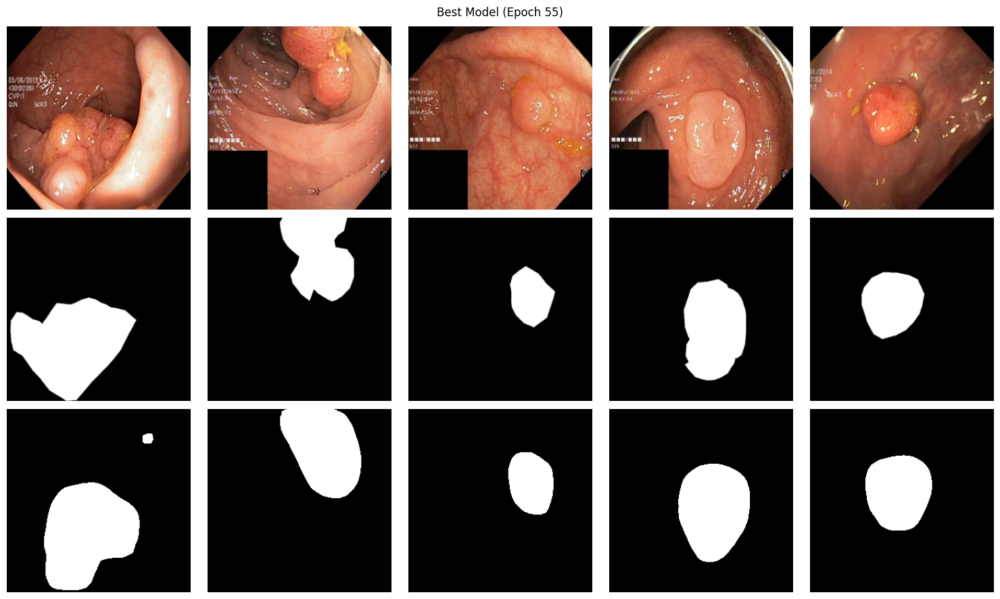

Epoch 56/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.77]



Epoch 56: Train Loss=0.5472 | Val Loss=0.4919 | Dice=0.7516 | IoU=0.6357



Epoch 57/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.768]



Epoch 57: Train Loss=0.5522 | Val Loss=0.5166 | Dice=0.7215 | IoU=0.5998



Epoch 58/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.716]



Epoch 58: Train Loss=0.5453 | Val Loss=0.4594 | Dice=0.7681 | IoU=0.6556

✅ Best model saved: checkpoints/best_model_epoch58_dice0.7681.pth


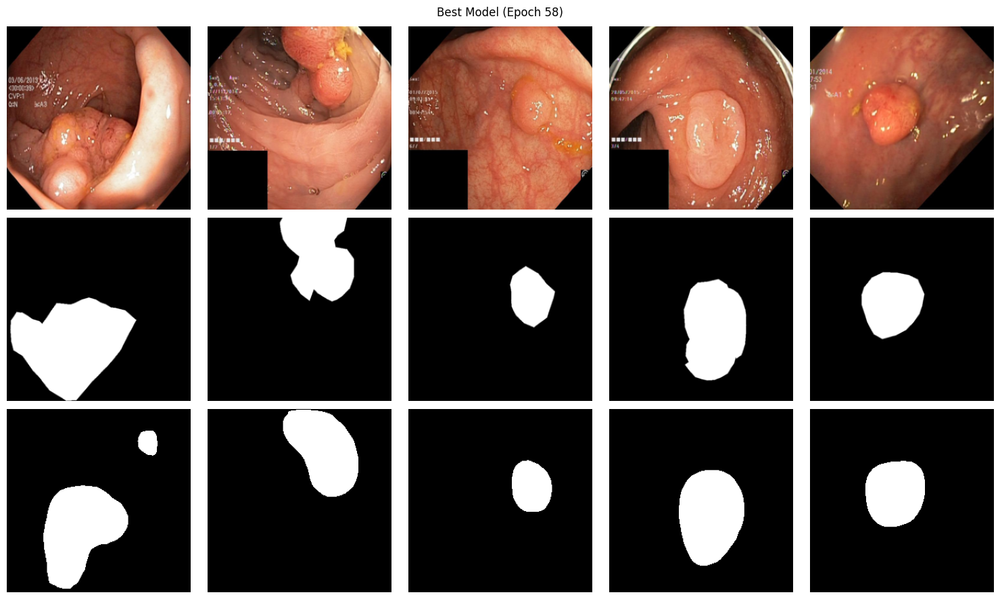

Epoch 59/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.416]



Epoch 59: Train Loss=0.5413 | Val Loss=0.4886 | Dice=0.7461 | IoU=0.6261



Epoch 60/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.456]



Epoch 60: Train Loss=0.5247 | Val Loss=0.5427 | Dice=0.7153 | IoU=0.5917



Epoch 61/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.318]



Epoch 61: Train Loss=0.5173 | Val Loss=0.4938 | Dice=0.7365 | IoU=0.6149



Epoch 62/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.52]



Epoch 62: Train Loss=0.5136 | Val Loss=0.4925 | Dice=0.7398 | IoU=0.6202



Epoch 63/100: 100%|██████████| 107/107 [01:01<00:00,  1.75it/s, loss=0.525]



Epoch 63: Train Loss=0.5057 | Val Loss=0.4453 | Dice=0.7655 | IoU=0.6534



Epoch 64/100: 100%|██████████| 107/107 [01:02<00:00,  1.71it/s, loss=0.462]



Epoch 64: Train Loss=0.5048 | Val Loss=0.4849 | Dice=0.7390 | IoU=0.6150



Epoch 65/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.299]



Epoch 65: Train Loss=0.5013 | Val Loss=0.5445 | Dice=0.7205 | IoU=0.5927



Epoch 66/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.856]



Epoch 66: Train Loss=0.4916 | Val Loss=0.4788 | Dice=0.7546 | IoU=0.6360



Epoch 67/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=1.17]



Epoch 67: Train Loss=0.4988 | Val Loss=0.4560 | Dice=0.7755 | IoU=0.6651

✅ Best model saved: checkpoints/best_model_epoch67_dice0.7755.pth


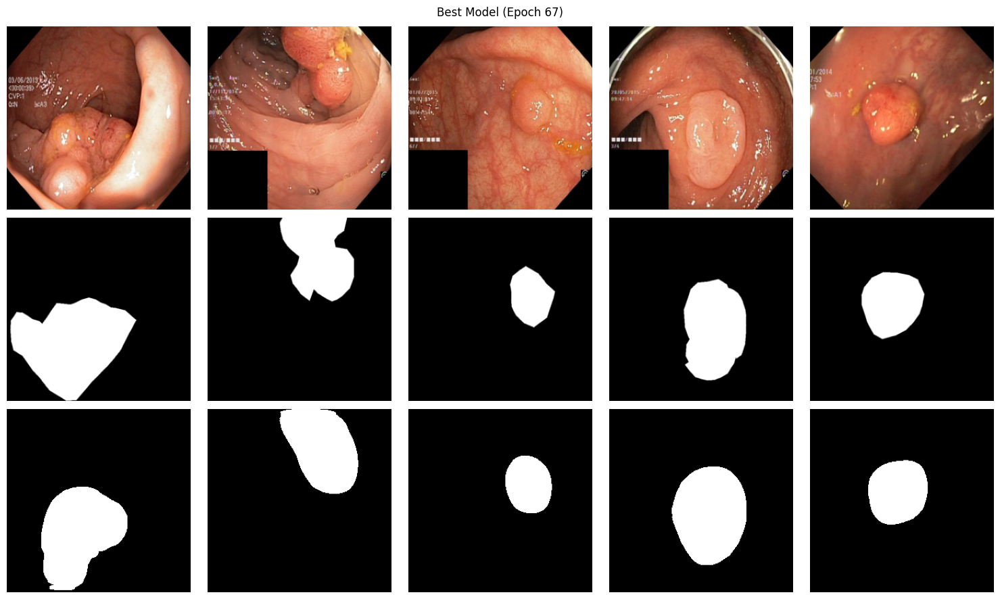

Epoch 68/100: 100%|██████████| 107/107 [01:01<00:00,  1.75it/s, loss=0.576]



Epoch 68: Train Loss=0.4938 | Val Loss=0.4987 | Dice=0.7513 | IoU=0.6359



Epoch 69/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.351]



Epoch 69: Train Loss=0.4904 | Val Loss=0.4952 | Dice=0.7503 | IoU=0.6325



Epoch 70/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.743]



Epoch 70: Train Loss=0.4800 | Val Loss=0.4911 | Dice=0.7507 | IoU=0.6296



Epoch 71/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.397]



Epoch 71: Train Loss=0.4651 | Val Loss=0.4830 | Dice=0.7570 | IoU=0.6418



Epoch 72/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.396]



Epoch 72: Train Loss=0.4694 | Val Loss=0.4787 | Dice=0.7445 | IoU=0.6227



Epoch 73/100: 100%|██████████| 107/107 [01:02<00:00,  1.71it/s, loss=0.517]



Epoch 73: Train Loss=0.4538 | Val Loss=0.4770 | Dice=0.7702 | IoU=0.6571



Epoch 74/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.874]



Epoch 74: Train Loss=0.4526 | Val Loss=0.4308 | Dice=0.7759 | IoU=0.6654

✅ Best model saved: checkpoints/best_model_epoch74_dice0.7759.pth


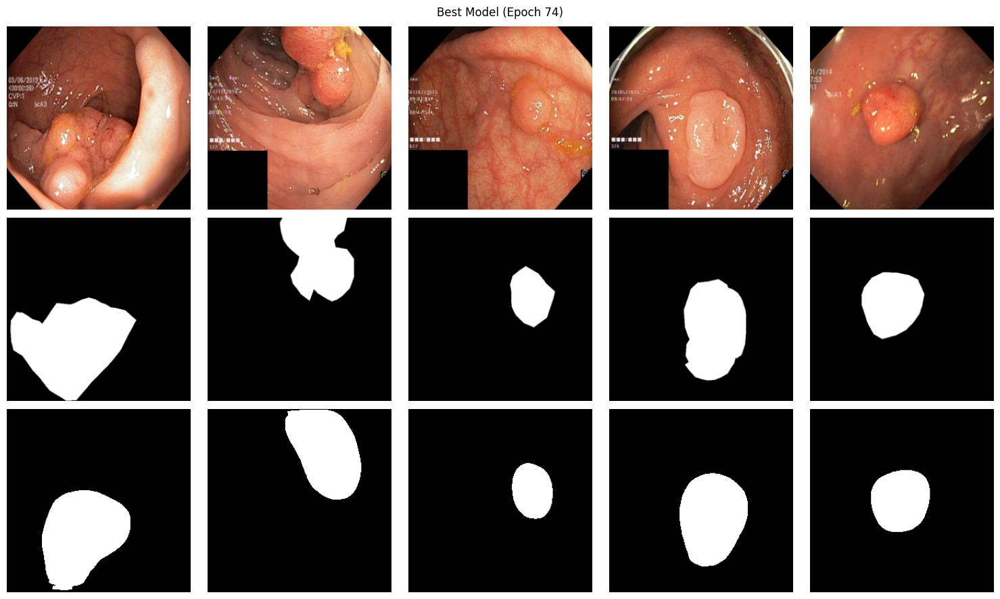

Epoch 75/100: 100%|██████████| 107/107 [01:02<00:00,  1.71it/s, loss=0.296]



Epoch 75: Train Loss=0.4388 | Val Loss=0.4867 | Dice=0.7351 | IoU=0.6150



Epoch 76/100: 100%|██████████| 107/107 [01:02<00:00,  1.71it/s, loss=0.394]



Epoch 76: Train Loss=0.4494 | Val Loss=0.4388 | Dice=0.7841 | IoU=0.6761

✅ Best model saved: checkpoints/best_model_epoch76_dice0.7841.pth


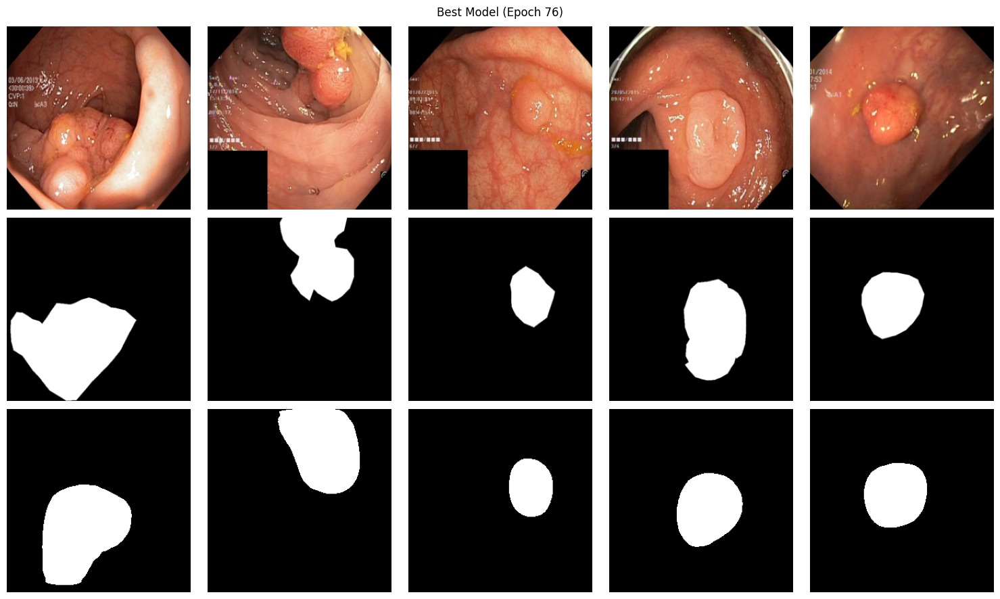

Epoch 77/100: 100%|██████████| 107/107 [01:01<00:00,  1.75it/s, loss=0.489]



Epoch 77: Train Loss=0.4508 | Val Loss=0.4689 | Dice=0.7633 | IoU=0.6522



Epoch 78/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.437]



Epoch 78: Train Loss=0.4347 | Val Loss=0.4408 | Dice=0.7754 | IoU=0.6664



Epoch 79/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.398]



Epoch 79: Train Loss=0.4270 | Val Loss=0.4401 | Dice=0.7713 | IoU=0.6588



Epoch 80/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.224]



Epoch 80: Train Loss=0.4288 | Val Loss=0.4742 | Dice=0.7512 | IoU=0.6371



Epoch 81/100: 100%|██████████| 107/107 [01:00<00:00,  1.76it/s, loss=0.501]



Epoch 81: Train Loss=0.4288 | Val Loss=0.4256 | Dice=0.7842 | IoU=0.6784

✅ Best model saved: checkpoints/best_model_epoch81_dice0.7842.pth


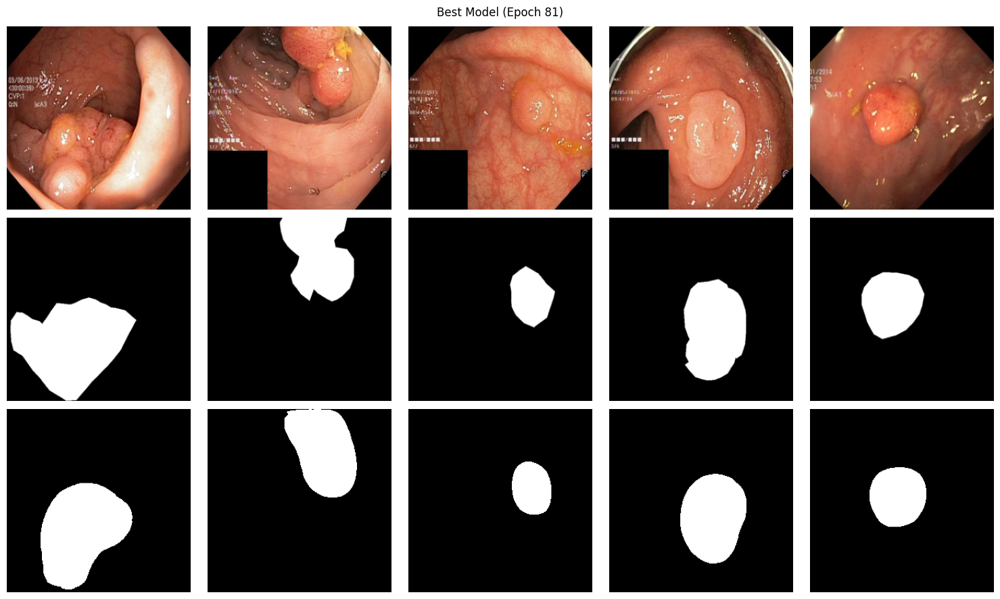

Epoch 82/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.339]



Epoch 82: Train Loss=0.4278 | Val Loss=0.4754 | Dice=0.7552 | IoU=0.6411



Epoch 83/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.229]



Epoch 83: Train Loss=0.4185 | Val Loss=0.4574 | Dice=0.7630 | IoU=0.6482



Epoch 84/100: 100%|██████████| 107/107 [01:02<00:00,  1.72it/s, loss=0.444]



Epoch 84: Train Loss=0.4115 | Val Loss=0.4885 | Dice=0.7579 | IoU=0.6431



Epoch 85/100: 100%|██████████| 107/107 [01:02<00:00,  1.70it/s, loss=0.444]



Epoch 85: Train Loss=0.4100 | Val Loss=0.4547 | Dice=0.7586 | IoU=0.6448



Epoch 86/100: 100%|██████████| 107/107 [01:03<00:00,  1.69it/s, loss=0.5]



Epoch 86: Train Loss=0.4048 | Val Loss=0.4604 | Dice=0.7593 | IoU=0.6484



Epoch 87/100: 100%|██████████| 107/107 [01:03<00:00,  1.70it/s, loss=0.56]



Epoch 87: Train Loss=0.4110 | Val Loss=0.4145 | Dice=0.7904 | IoU=0.6891

✅ Best model saved: checkpoints/best_model_epoch87_dice0.7904.pth


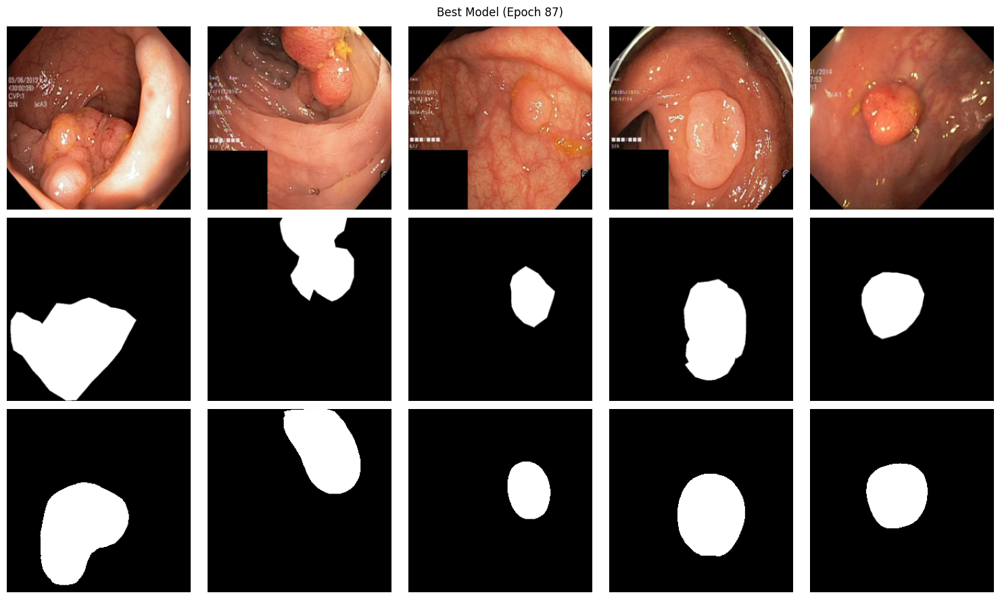

Epoch 88/100: 100%|██████████| 107/107 [01:03<00:00,  1.70it/s, loss=0.434]



Epoch 88: Train Loss=0.4202 | Val Loss=0.4378 | Dice=0.7795 | IoU=0.6763



Epoch 89/100: 100%|██████████| 107/107 [01:03<00:00,  1.69it/s, loss=0.501]



Epoch 89: Train Loss=0.4023 | Val Loss=0.4412 | Dice=0.7717 | IoU=0.6663



Epoch 90/100: 100%|██████████| 107/107 [01:02<00:00,  1.72it/s, loss=0.263]



Epoch 90: Train Loss=0.3886 | Val Loss=0.4302 | Dice=0.7864 | IoU=0.6823



Epoch 91/100: 100%|██████████| 107/107 [01:01<00:00,  1.73it/s, loss=0.479]



Epoch 91: Train Loss=0.3919 | Val Loss=0.4443 | Dice=0.7700 | IoU=0.6627



Epoch 92/100: 100%|██████████| 107/107 [01:01<00:00,  1.73it/s, loss=0.364]



Epoch 92: Train Loss=0.3991 | Val Loss=0.4737 | Dice=0.7599 | IoU=0.6481



Epoch 93/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.766]



Epoch 93: Train Loss=0.4101 | Val Loss=0.4608 | Dice=0.7774 | IoU=0.6745



Epoch 94/100: 100%|██████████| 107/107 [01:01<00:00,  1.73it/s, loss=0.237]



Epoch 94: Train Loss=0.4015 | Val Loss=0.5469 | Dice=0.7288 | IoU=0.6140



Epoch 95/100: 100%|██████████| 107/107 [01:01<00:00,  1.73it/s, loss=0.349]



Epoch 95: Train Loss=0.3859 | Val Loss=0.4886 | Dice=0.7521 | IoU=0.6386



Epoch 96/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.375]



Epoch 96: Train Loss=0.3806 | Val Loss=0.4319 | Dice=0.7877 | IoU=0.6826



Epoch 97/100: 100%|██████████| 107/107 [01:01<00:00,  1.73it/s, loss=0.38]



Epoch 97: Train Loss=0.3835 | Val Loss=0.4292 | Dice=0.7755 | IoU=0.6709



Epoch 98/100: 100%|██████████| 107/107 [01:02<00:00,  1.72it/s, loss=0.485]



Epoch 98: Train Loss=0.3737 | Val Loss=0.4278 | Dice=0.7898 | IoU=0.6888



Epoch 99/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.417]



Epoch 99: Train Loss=0.3845 | Val Loss=0.3968 | Dice=0.7987 | IoU=0.7009

✅ Best model saved: checkpoints/best_model_epoch99_dice0.7987.pth


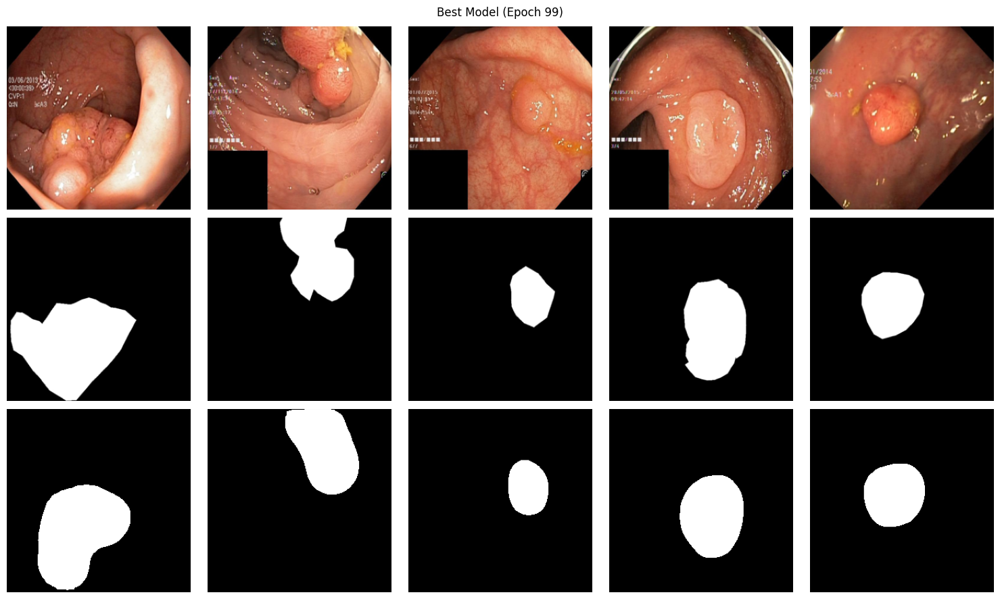

Epoch 100/100: 100%|██████████| 107/107 [01:01<00:00,  1.74it/s, loss=0.344]



Epoch 100: Train Loss=0.3875 | Val Loss=0.4390 | Dice=0.7859 | IoU=0.6822



In [5]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter
from tqdm import tqdm
import os

# --- Dice Loss ---
def dice_loss(pred, target, smooth=1.):
    pred = torch.sigmoid(pred)
    intersection = (pred * target).sum(dim=(2, 3))
    union = pred.sum(dim=(2, 3)) + target.sum(dim=(2, 3))
    dice = (2. * intersection + smooth) / (union + smooth)
    return 1 - dice.mean()

# --- Combined BCE + Dice Loss (Boundary Removed) ---
def combined_loss(preds, target):
    bce = nn.BCEWithLogitsLoss()
    weights = [0.6, 0.2, 0.1, 0.1]
    total_loss = 0
    for i, pred in enumerate(preds):
        loss_bce = bce(pred, target)
        loss_dice = dice_loss(pred, target)
        total = loss_bce + loss_dice
        total_loss += weights[i] * total
    return total_loss

# --- Metrics ---
def calc_metrics(pred, target):
    pred = torch.sigmoid(pred) > 0.5
    target = target.bool()
    intersection = (pred & target).float().sum((1, 2, 3))
    union = (pred | target).float().sum((1, 2, 3))
    iou = (intersection / (union + 1e-6)).mean()
    dice = (2 * intersection / (pred.sum((1, 2, 3)) + target.sum((1, 2, 3)) + 1e-6)).mean()
    return dice.item(), iou.item()

# --- TensorBoard Writer ---
writer = SummaryWriter(log_dir="runs/AttentionUNetPlusPlus")

# --- Training Loop ---
best_dice = 0.0
os.makedirs("checkpoints", exist_ok=True)
os.makedirs("visualizations", exist_ok=True)

for epoch in range(epochs):
    model.train()
    train_loss = 0
    with tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs}") as pbar:
        for img, mask in pbar:
            img, mask = img.to(device), mask.to(device)
            optimizer.zero_grad()
            outputs = model(img)
            loss = combined_loss(outputs, mask)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
            pbar.set_postfix({"loss": loss.item()})

    # --- Validation ---
    model.eval()
    val_loss, dice_total, iou_total = 0, 0, 0
    with torch.no_grad():
        for img, mask in val_loader:
            img, mask = img.to(device), mask.to(device)
            outputs = model(img)
            loss = combined_loss(outputs, mask)
            val_loss += loss.item()
            dice, iou = calc_metrics(outputs[0], mask)
            dice_total += dice
            iou_total += iou

    avg_train_loss = train_loss / len(train_loader)
    avg_val_loss = val_loss / len(val_loader)
    avg_dice = dice_total / len(val_loader)
    avg_iou = iou_total / len(val_loader)

    print(f"\nEpoch {epoch+1}: "
          f"Train Loss={avg_train_loss:.4f} | "
          f"Val Loss={avg_val_loss:.4f} | "
          f"Dice={avg_dice:.4f} | IoU={avg_iou:.4f}\n")

    # --- TensorBoard Logging ---
    writer.add_scalar("Loss/Train", avg_train_loss, epoch)
    writer.add_scalar("Loss/Validation", avg_val_loss, epoch)
    writer.add_scalar("Metrics/Dice", avg_dice, epoch)
    writer.add_scalar("Metrics/IoU", avg_iou, epoch)

    # --- Save Best Model & Visualization ---
    if avg_dice > best_dice:
        best_dice = avg_dice
        ckpt_path = f"checkpoints/best_model_epoch{epoch+1}_dice{avg_dice:.4f}.pth"
        torch.save(model.state_dict(), ckpt_path)
        print(f"✅ Best model saved: {ckpt_path}")

        vis_path = f"visualizations/epoch{epoch+1}_dice{avg_dice:.4f}.png"
        visualize_predictions(val_loader, f"Best Model (Epoch {epoch+1})", save_path=vis_path)

        # Optional: Log predictions to TensorBoard
        inputs, targets = next(iter(val_loader))
        inputs, targets = inputs.to(device), targets.to(device)
        outputs = model(inputs)
        if isinstance(outputs, tuple):
            outputs = outputs[0]
        preds = torch.sigmoid(outputs) > 0.5
        writer.add_images("Sample/Input", inputs[:4], epoch)
        writer.add_images("Sample/GroundTruth", targets[:4], epoch)
        writer.add_images("Sample/Prediction", preds[:4].float(), epoch)

writer.close()
